In [ ]:
from keras.models import Sequential
from keras.layers import Convolution2D  # convolution Layer
from keras.layers import MaxPooling2D   # Pooling Layer
from keras.layers import Flatten        # Flatten
from keras.layers import Dense          # Hidden Layer & Output Layer

import warnings
warnings.filterwarnings("ignore")

In [ ]:
# !pip install keras

   ---------------------------------------- 0.0/1.2 MB ? eta -:--:--
   ---------------------------------------- 0.0/1.2 MB ? eta -:--:--
   -------- ------------------------------- 0.3/1.2 MB ? eta -:--:--
   -------------------------- ------------- 0.8/1.2 MB 3.4 MB/s eta 0:00:01
   ---------------------------------------- 1.2/1.2 MB 3.5 MB/s eta 0:00:00
   ---------------------------------------- 0.0/3.0 MB ? eta -:--:--
   -------------- ------------------------- 1.0/3.0 MB 12.5 MB/s eta 0:00:01
   -------------------------------------- - 2.9/3.0 MB 7.6 MB/s eta 0:00:01
   ---------------------------------------- 3.0/3.0 MB 7.3 MB/s eta 0:00:00


In [ ]:
# !pip install tensorflow

Defaulting to user installation because normal site-packages is not writeable
  Obtaining dependency information for tensorflow from https://files.pythonhosted.org/packages/cf/24/271e77c22724f370c24c705f394b8035b4d27e4c2c6339f3f45ab9b8258e/tensorflow-2.18.0-cp311-cp311-win_amd64.whl.metadata
  Obtaining dependency information for tensorflow-intel==2.18.0 from https://files.pythonhosted.org/packages/76/ad/fa6c508a15ff79cb5409294c293388e0999b7d480f84b65e4287277434fe/tensorflow_intel-2.18.0-cp311-cp311-win_amd64.whl.metadata
  Obtaining dependency information for astunparse>=1.6.0 from https://files.pythonhosted.org/packages/2b/03/13dde6512ad7b4557eb792fbcf0c653af6076b81e5941d36ec61f7ce6028/astunparse-1.6.3-py2.py3-none-any.whl.metadata
  Obtaining dependency information for flatbuffers>=24.3.25 from https://files.pythonhosted.org/packages/41/f0/7e988a019bc54b2dbd0ad4182ef2d53488bb02e58694cd79d61369e85900/flatbuffers-24.3.25-py2.py3-none-any.whl.metadata
  Obtaining dependency information

  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gensim 4.3.0 requires FuzzyTM>=0.4.0, which is not installed.
tables 3.8.0 requires blosc2~=2.0.0, which is not installed.
tables 3.8.0 requires cython>=0.29.21, which is not installed.
numba 0.57.1 requires numpy<1.25,>=1.21, but you have numpy 2.0.2 which is incompatible.
scipy 1.11.1 requires numpy<1.28.0,>=1.21.6, but you have numpy 2.0.2 which is incompatible.


   ------- -------------------------------- 69.6/390.2 MB 2.9 MB/s eta 0:01:52
   ------- -------------------------------- 69.7/390.2 MB 2.9 MB/s eta 0:01:53
   ------- -------------------------------- 69.8/390.2 MB 2.8 MB/s eta 0:01:53
   ------- -------------------------------- 69.9/390.2 MB 2.8 MB/s eta 0:01:54
   ------- -------------------------------- 70.0/390.2 MB 2.9 MB/s eta 0:01:52
   ------- -------------------------------- 70.1/390.2 MB 2.9 MB/s eta 0:01:52
   ------- -------------------------------- 70.2/390.2 MB 2.9 MB/s eta 0:01:52
   ------- -------------------------------- 70.2/390.2 MB 2.8 MB/s eta 0:01:53
   ------- -------------------------------- 70.3/390.2 MB 2.8 MB/s eta 0:01:54
   ------- -------------------------------- 70.4/390.2 MB 2.8 MB/s eta 0:01:55
   ------- -------------------------------- 70.4/390.2 MB 2.8 MB/s eta 0:01:55
   ------- -------------------------------- 70.4/390.2 MB 2.8 MB/s eta 0:01:56
   ------- -------------------------------- 70.5/390

In [ ]:
# Initialising the CNN
classifier = Sequential()

################### CNN - 1 ###################
# Step 1 - Convolution Layer
classifier.add(Convolution2D(32, (3, 3) , input_shape = (64, 64, 3), activation = 'relu')) # entire image

# Step 2 - Pooling Layer
classifier.add(MaxPooling2D(pool_size = (2, 2)))

################### CNN - 2 ###################

classifier.add(Convolution2D(32, (3, 3) , activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))


#################### Flattening Layer ###################
classifier.add(Flatten())

#################### Step 4 - Full connection  ( Neural Netwokr) ###################
classifier.add(Dense(units = 128, activation = 'relu'))   ## 1 HIDDEN LAYER WITH 128 NEURONS
classifier.add(Dense(units = training_set.num_classes , activation = 'softmax'))  ## OUTPUT LAYER WITH NUM_CLASSES NEURONS # softmax for multi-class classification

In [ ]:
# Compiling the CNN
classifier.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
classifier.summary()

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)                    │ (None, 62, 62, 32)          │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_8 (MaxPooling2D)       │ (None, 31, 31, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_9 (Conv2D)                    │ (None, 29, 29, 32)          │           9,248 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_9 (MaxPooling2D)       │ (None, 14, 14, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_4 (Flatten)                  │ (None, 6272)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 128)                 │         802,944 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 34)                  │           4,386 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 817,474 (3.12 MB)

 Trainable params: 817,474 (3.12 MB)

 Non-trainable params: 0 (0.00 B)

## Splitting the entire data into train and test (80:20)

In [ ]:
# !pip install splitfolders
import splitfolders
splitfolders.ratio('F:\Work\DL_Test2\Food Classification dataset\Data', output="F:\Work\DL_Test2\Food Classification dataset\split_data", seed=1337, ratio=(.8, 0.0,0.2))

Copying files: 23873 files [00:09, 2488.42 files/s]


In [ ]:
# Part 2 - Fitting the CNN to the images
import tensorflow as tf

train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale = 1./255)  # max normilization


test_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale = 1./255)

training_set = train_datagen.flow_from_directory(r"F:\Work\DL_Test2\Food Classification dataset\split_data\train",
                                                 target_size = (64, 64),  # HEIGHT AND WIDTH
                                                 batch_size = 34, # take 32 group which pick image randomly without replacement
                                                 class_mode = 'categorical') # categorical because we have many food types

test_set = test_datagen.flow_from_directory(r"F:\Work\DL_Test2\Food Classification dataset\split_data\test",
                                            target_size = (64, 64),
                                            batch_size = 34,
                                            class_mode = 'categorical')


Found 19092 images belonging to 34 classes.
Found 4781 images belonging to 34 classes.


In [ ]:
19092/32  # each group will have 250 image unique

596.625

In [ ]:
training_set.class_indices

{'Baked Potato': 0,
 'Crispy Chicken': 1,
 'Donut': 2,
 'Fries': 3,
 'Hot Dog': 4,
 'Sandwich': 5,
 'Taco': 6,
 'Taquito': 7,
 'apple_pie': 8,
 'burger': 9,
 'butter_naan': 10,
 'chai': 11,
 'chapati': 12,
 'cheesecake': 13,
 'chicken_curry': 14,
 'chole_bhature': 15,
 'dal_makhani': 16,
 'dhokla': 17,
 'fried_rice': 18,
 'ice_cream': 19,
 'idli': 20,
 'jalebi': 21,
 'kaathi_rolls': 22,
 'kadai_paneer': 23,
 'kulfi': 24,
 'masala_dosa': 25,
 'momos': 26,
 'omelette': 27,
 'paani_puri': 28,
 'pakode': 29,
 'pav_bhaji': 30,
 'pizza': 31,
 'samosa': 32,
 'sushi': 33}

In [ ]:
for data_batch, labels_batch in training_set:
    print('train data batch shape:', data_batch.shape)
    print('train labels batch shape:', labels_batch.shape)
    break

for data_batch, labels_batch in test_set:
    print('test data batch shape:', data_batch.shape)
    print('test labels batch shape:', labels_batch.shape)
    break

data batch shape: (34, 64, 64, 3)
labels batch shape: (34, 34)
data batch shape: (34, 64, 64, 3)
labels batch shape: (34, 34)


In [ ]:
result = classifier.fit(training_set,
                         epochs=10, # iteration or repeat
                         validation_data = test_set)

Epoch 1/10
562/562 ━━━━━━━━━━━━━━━━━━━━ 54s 95ms/step - accuracy: 0.1173 - loss: 3.1258 - val_accuracy: 0.2466 - val_loss: 2.6406
Epoch 2/10
562/562 ━━━━━━━━━━━━━━━━━━━━ 49s 86ms/step - accuracy: 0.2678 - loss: 2.5184 - val_accuracy: 0.2661 - val_loss: 2.5280
Epoch 3/10
562/562 ━━━━━━━━━━━━━━━━━━━━ 48s 85ms/step - accuracy: 0.3429 - loss: 2.2470 - val_accuracy: 0.2989 - val_loss: 2.4764
Epoch 4/10
562/562 ━━━━━━━━━━━━━━━━━━━━ 47s 84ms/step - accuracy: 0.4168 - loss: 1.9945 - val_accuracy: 0.3246 - val_loss: 2.4158
Epoch 5/10
562/562 ━━━━━━━━━━━━━━━━━━━━ 47s 83ms/step - accuracy: 0.4782 - loss: 1.7713 - val_accuracy: 0.3524 - val_loss: 2.3365
Epoch 6/10
562/562 ━━━━━━━━━━━━━━━━━━━━ 49s 87ms/step - accuracy: 0.5430 - loss: 1.5364 - val_accuracy: 0.3522 - val_loss: 2.4303
Epoch 7/10
562/562 ━━━━━━━━━━━━━━━━━━━━ 48s 86ms/step - accuracy: 0.6055 - loss: 1.3203 - val_accuracy: 0.3399 - val_loss: 2.5808
Epoch 8/10
562/562 ━━━━━━━━━━━━━━━━━━━━ 48s 85ms/step - accuracy: 0.6687 - loss: 1.1099 - 

In [ ]:
classifier.save('food_classifier.h5')

In [ ]:
from keras.models import load_model
from keras_preprocessing import image
import numpy as np
import cv2   #pip install opencv-python
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
# !pip install keras_preprocessing

Defaulting to user installation because normal site-packages is not writeable
  Obtaining dependency information for keras_preprocessing from https://files.pythonhosted.org/packages/79/4c/7c3275a01e12ef9368a892926ab932b33bb13d55794881e3573482b378a7/Keras_Preprocessing-1.1.2-py2.py3-none-any.whl.metadata
   ---------------------------------------- 0.0/42.6 kB ? eta -:--:--
   ---------------------------------------- 0.0/42.6 kB ? eta -:--:--
   --------- ------------------------------ 10.2/42.6 kB ? eta -:--:--
   ------------------- -------------------- 20.5/42.6 kB 217.9 kB/s eta 0:00:01
   ---------------------------- ----------- 30.7/42.6 kB 262.6 kB/s eta 0:00:01
   ---------------------------------------- 42.6/42.6 kB 258.7 kB/s eta 0:00:00


In [ ]:
# !pip install opencv-python

Defaulting to user installation because normal site-packages is not writeable
  Obtaining dependency information for opencv-python from https://files.pythonhosted.org/packages/ec/6c/fab8113424af5049f85717e8e527ca3773299a3c6b02506e66436e19874f/opencv_python-4.10.0.84-cp37-abi3-win_amd64.whl.metadata
   ---------------------------------------- 0.0/38.8 MB ? eta -:--:--
   ---------------------------------------- 0.0/38.8 MB ? eta -:--:--
   ---------------------------------------- 0.0/38.8 MB 435.7 kB/s eta 0:01:30
   ---------------------------------------- 0.1/38.8 MB 656.4 kB/s eta 0:01:00
   ---------------------------------------- 0.2/38.8 MB 1.1 MB/s eta 0:00:34
   ---------------------------------------- 0.2/38.8 MB 1.1 MB/s eta 0:00:35
   ---------------------------------------- 0.3/38.8 MB 1.5 MB/s eta 0:00:26
   ---------------------------------------- 0.4/38.8 MB 1.7 MB/s eta 0:00:24
    --------------------------------------- 0.5/38.8 MB 1.8 MB/s eta 0:00:22
    -------------

In [ ]:
reload_model = load_model("food_classifier.h5")

In [ ]:
def model_output(path):
    raw_img = image.load_img(path, target_size=(64, 64))  # importing image is converted to 64*64
    raw_img = image.img_to_array(raw_img)  # convert image to array
    raw_img = np.expand_dims(raw_img, axis=0)
    raw_img = raw_img / 255  # data max normalization
    probabilities = reload_model.predict(raw_img)[0]  # get probabilities for each class
    predicted_class = np.argmax(probabilities)  # get the index of the highest probability
    class_labels = list(training_set.class_indices.keys())  # get class labels from training set
    predicted_label = class_labels[predicted_class]  # get the label of the predicted class
    plt.imshow(cv2.imread(path))  # Display Image
    plt.title(f'Predicted: {predicted_label}, Probability: {probabilities[predicted_class]:.2f}')
    plt.show()

In [ ]:
import os
os.chdir(r"F:\Work\DL_Test2\Food Classification dataset\split_data\output")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step


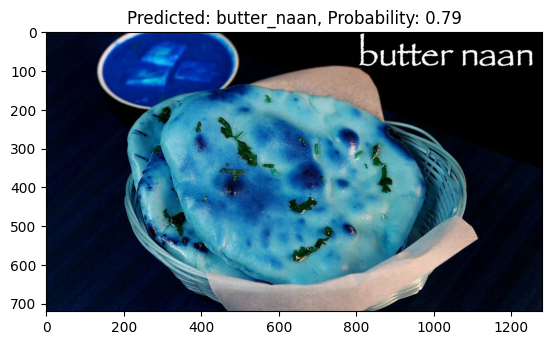

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


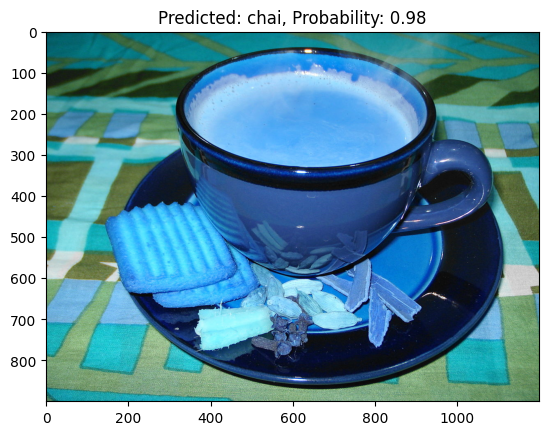

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


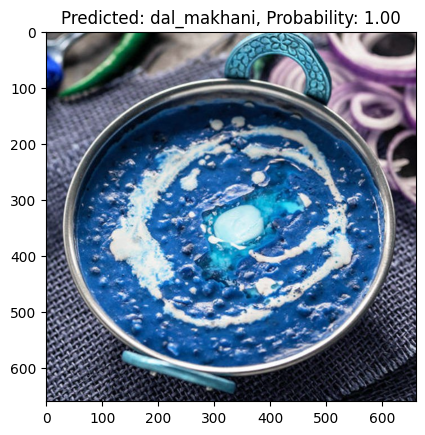

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


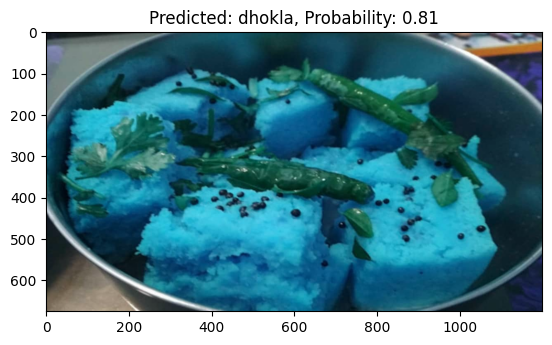

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


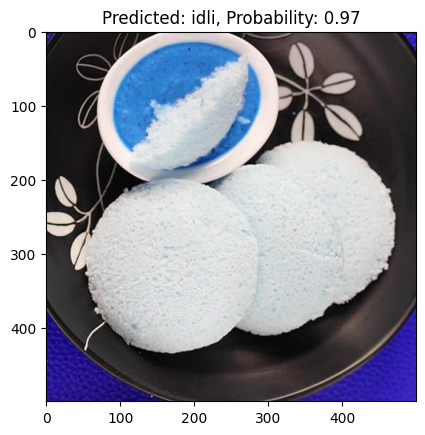

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


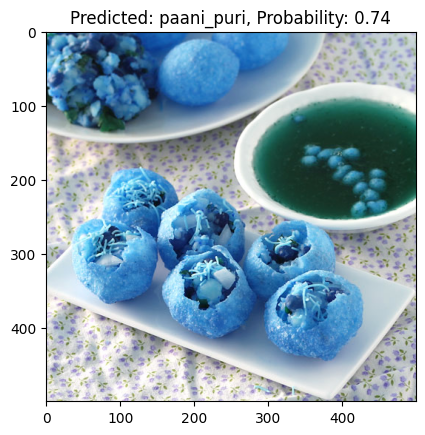

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


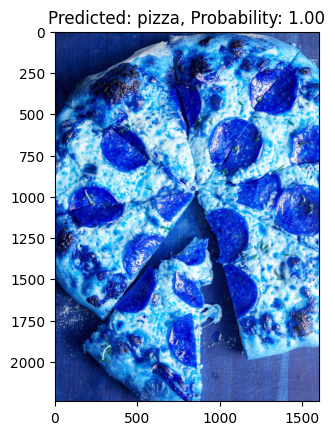

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


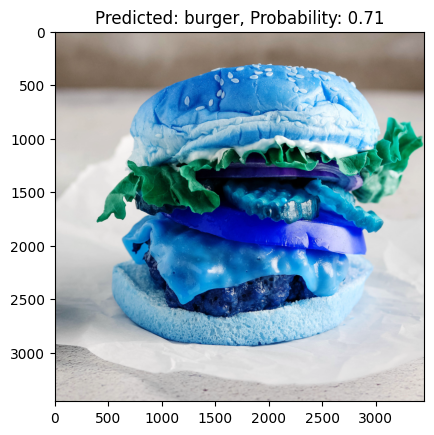

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


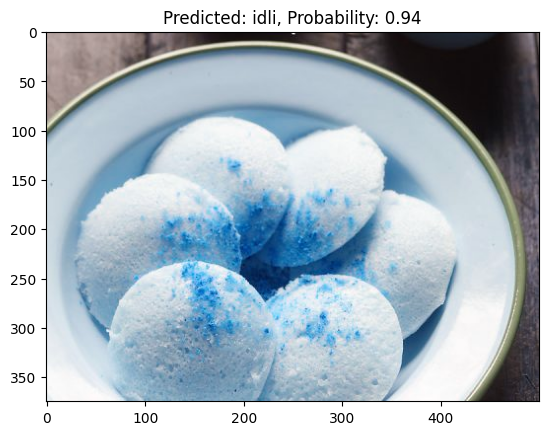

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


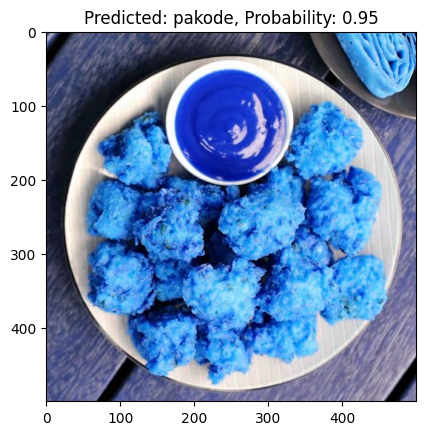

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


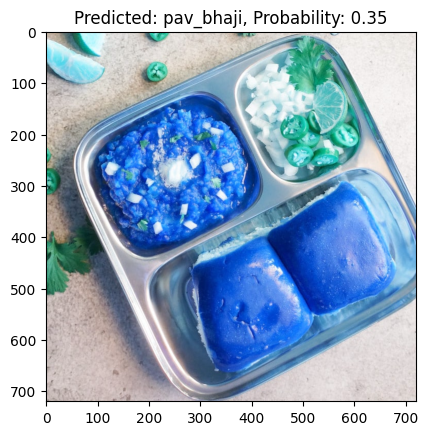

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


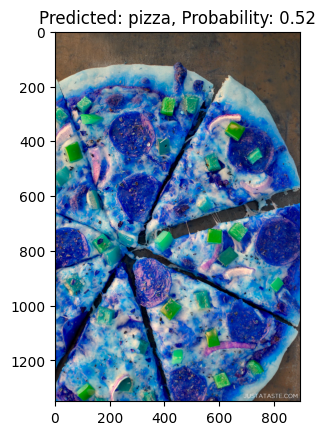

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


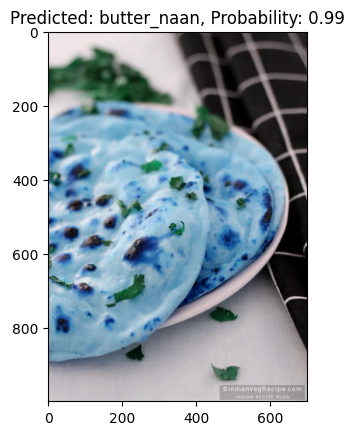

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


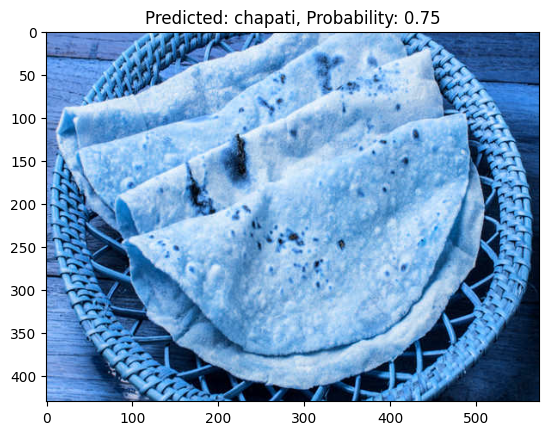

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


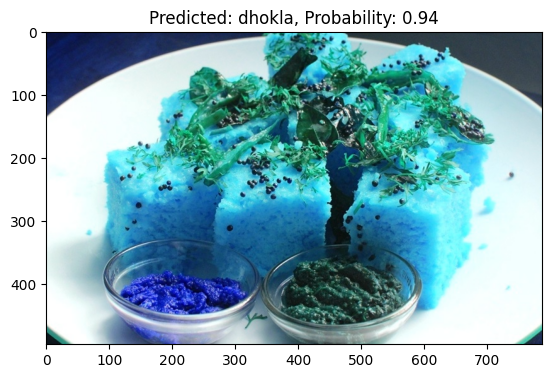

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


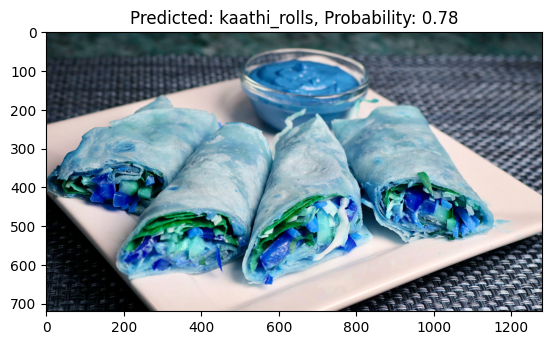

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


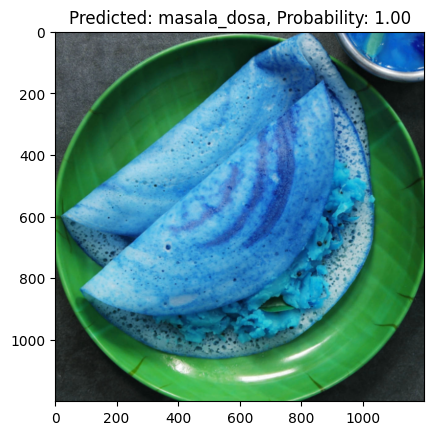

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


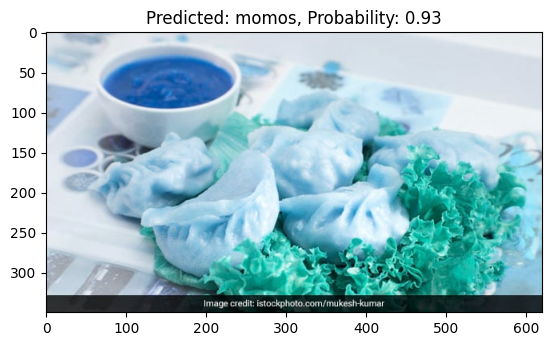

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


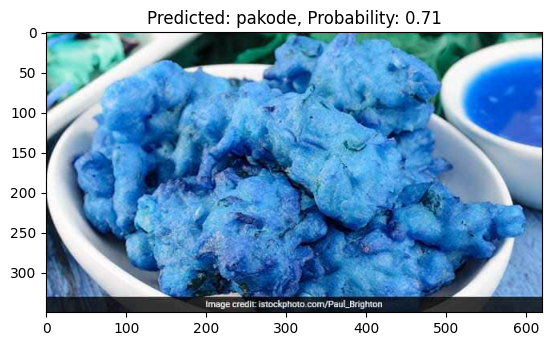

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


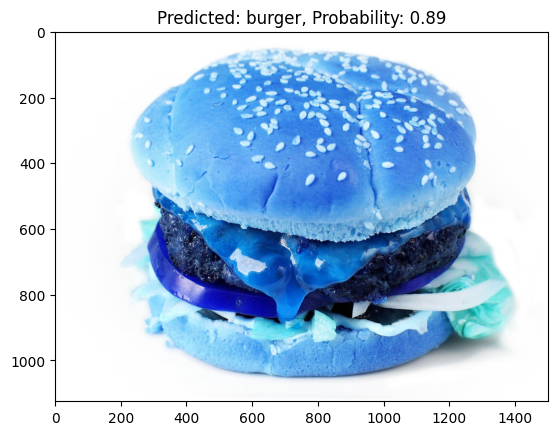

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


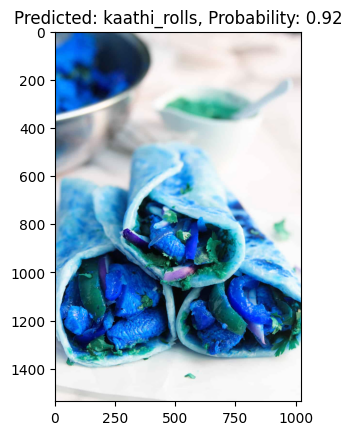

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


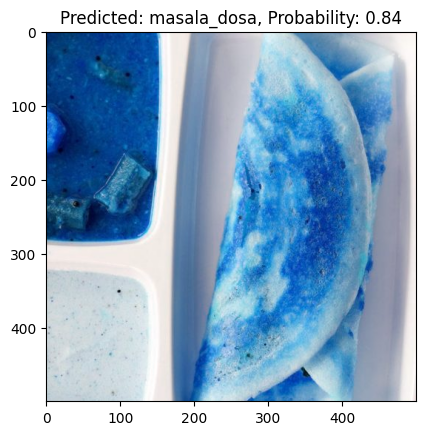

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


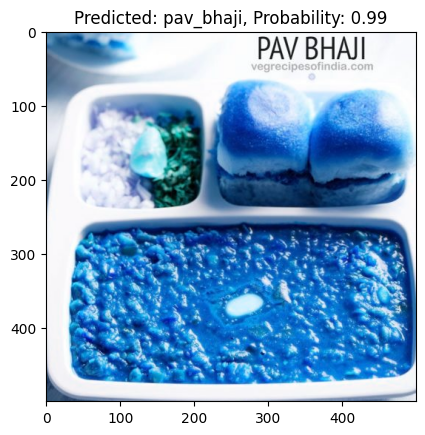

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


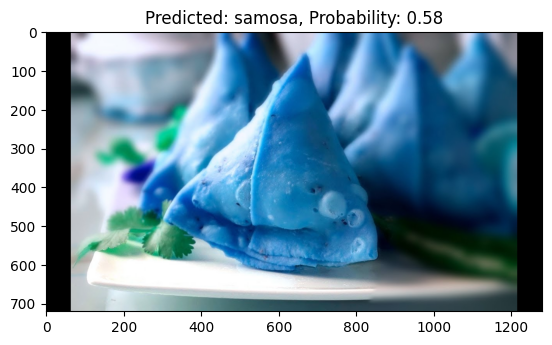

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


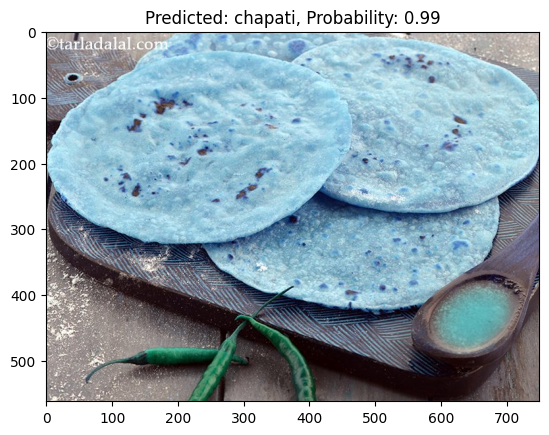

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


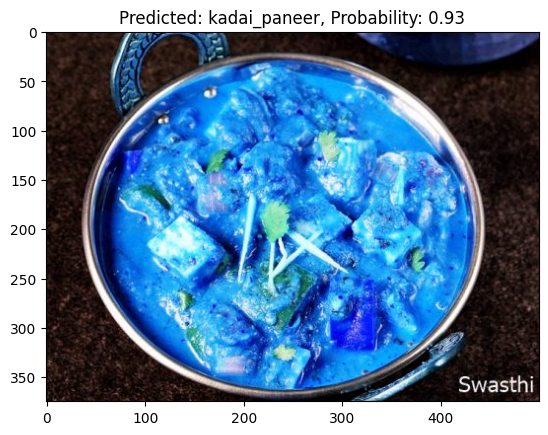

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


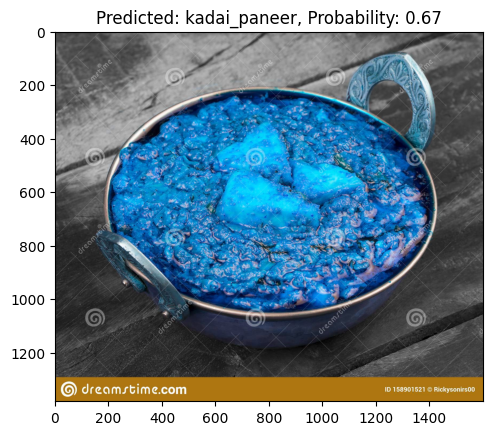

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


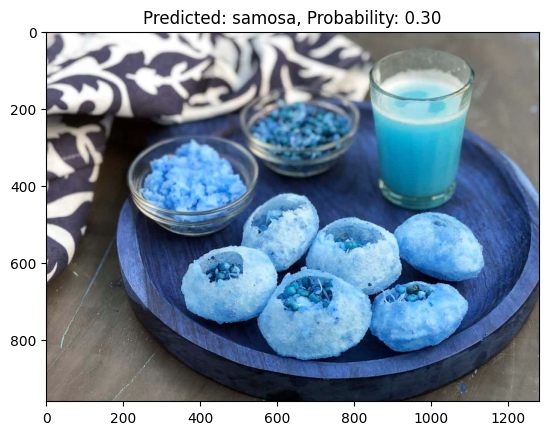

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


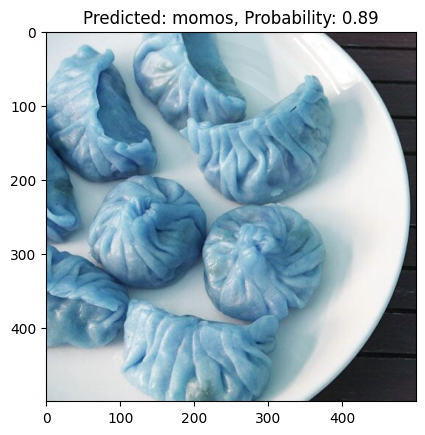

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step


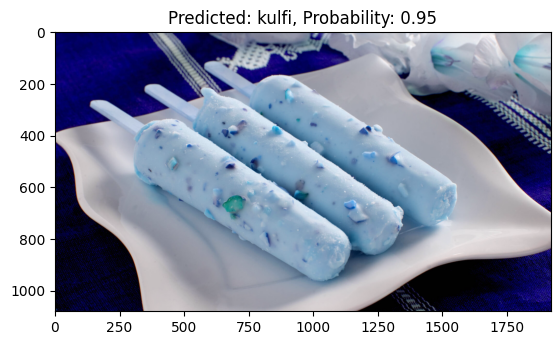

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


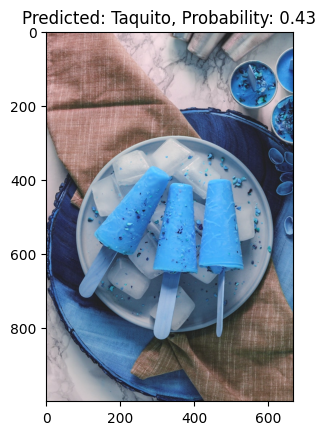

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


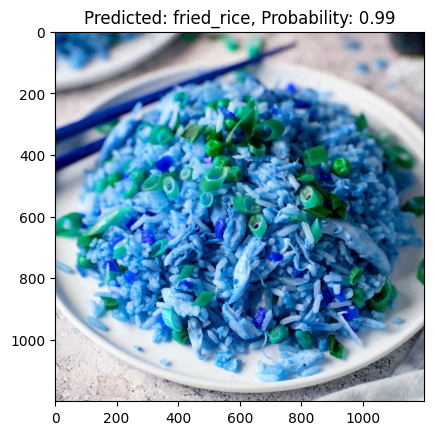

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


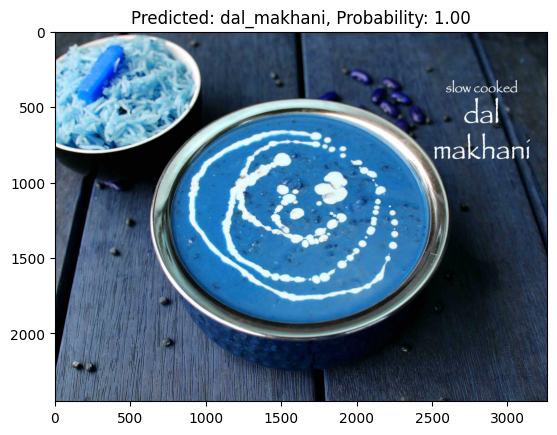

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


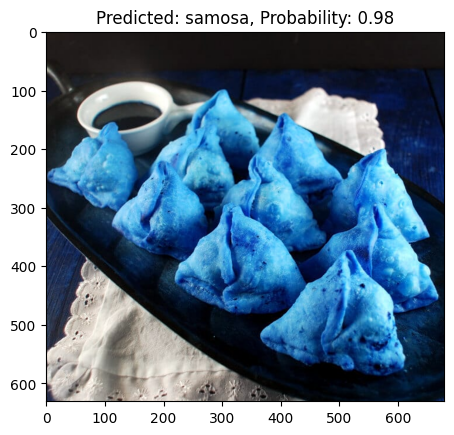

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step


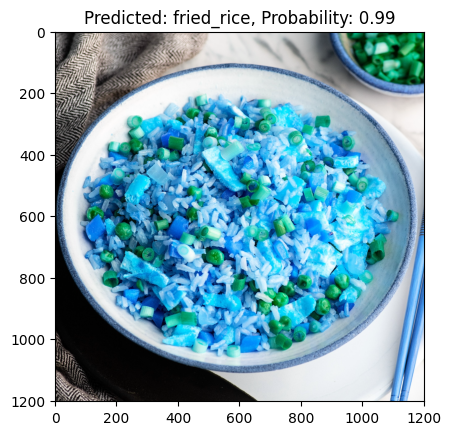

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


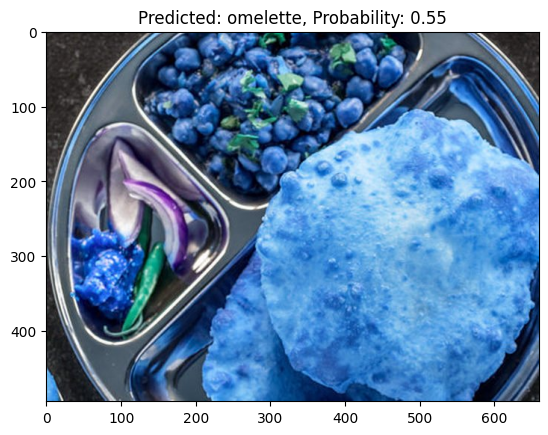

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


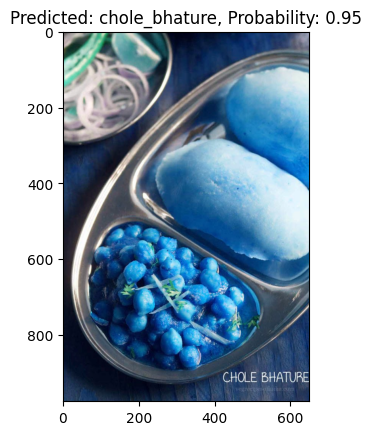

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


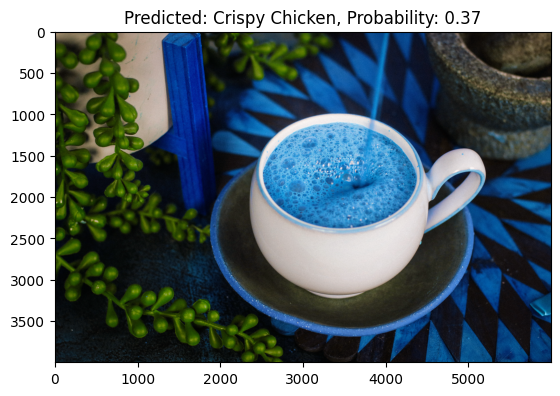

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


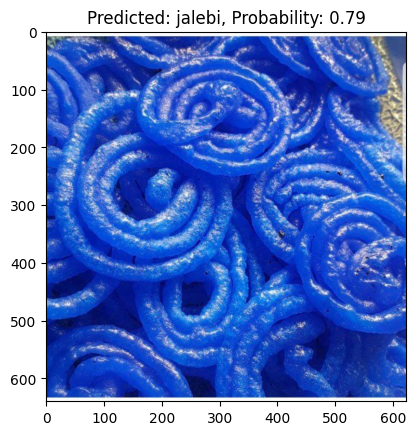

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


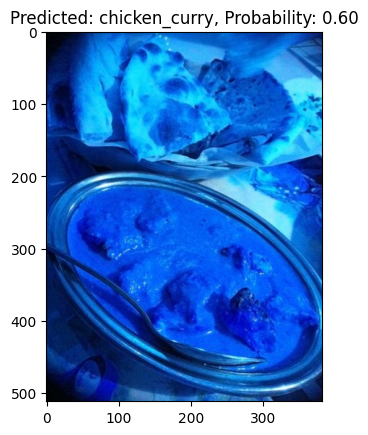

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


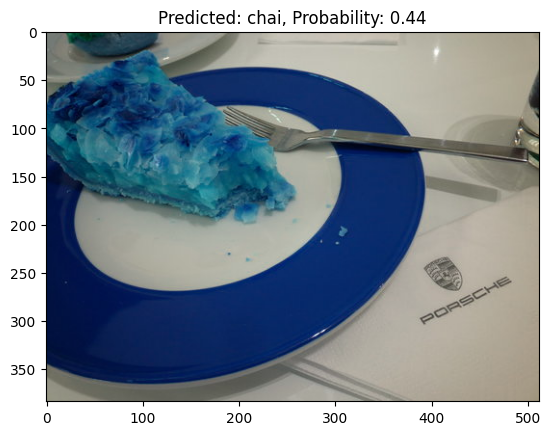

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


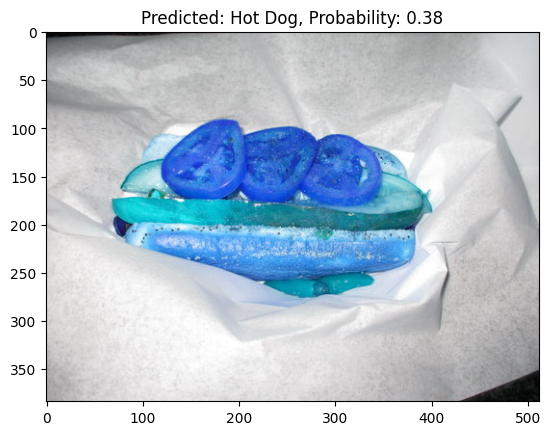

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


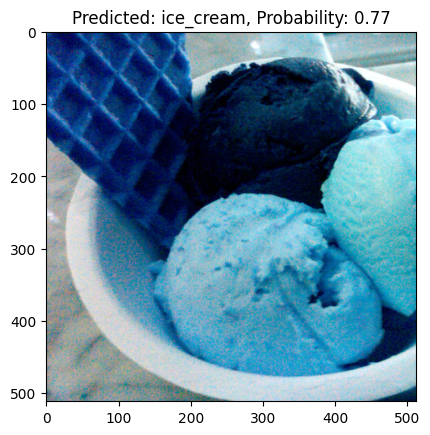

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


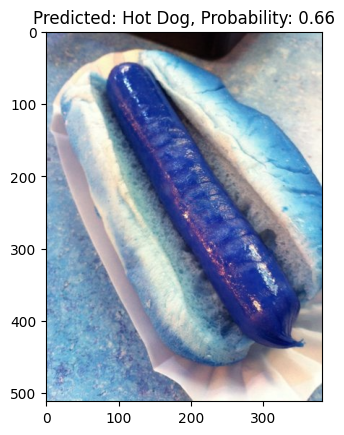

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


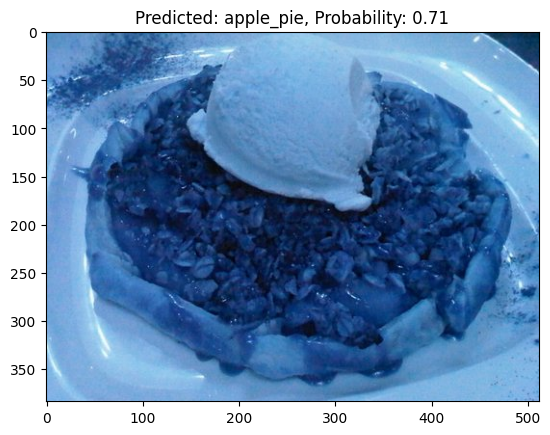

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


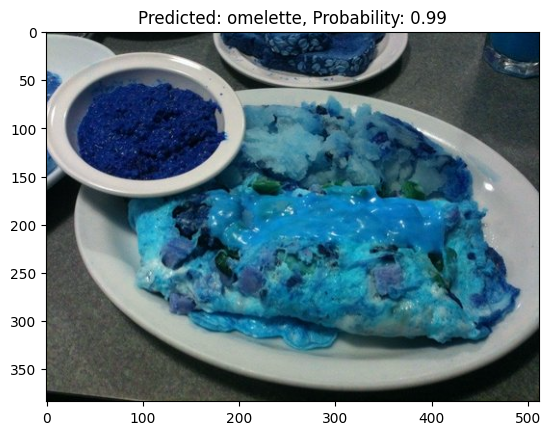

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


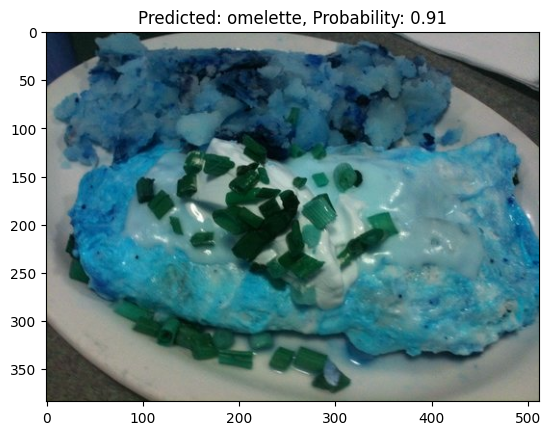

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


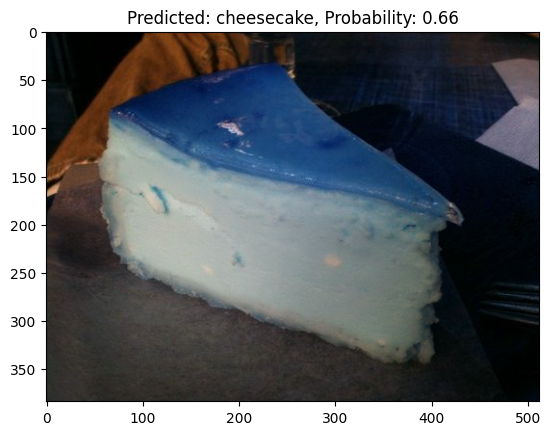

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


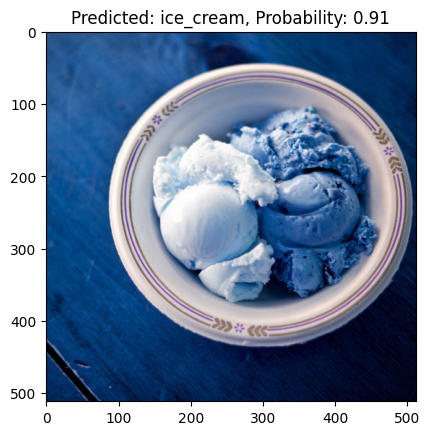

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


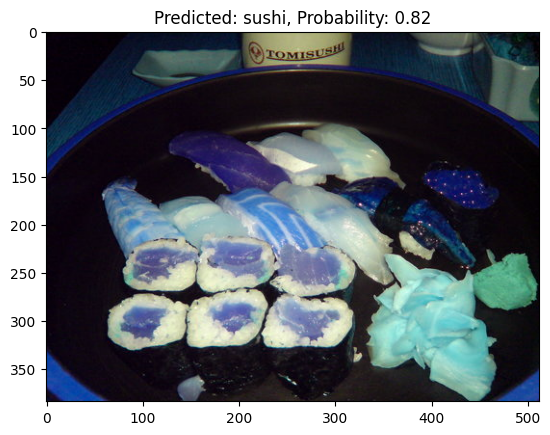

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


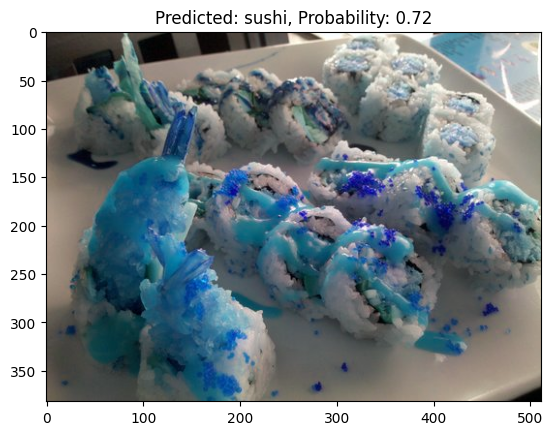

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


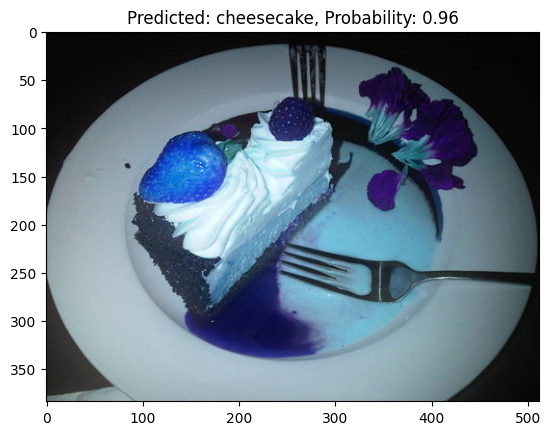

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


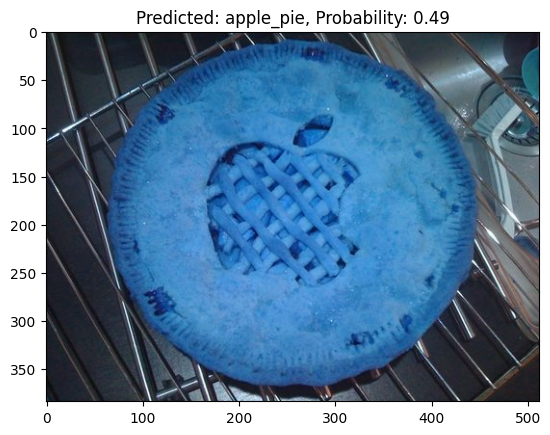

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


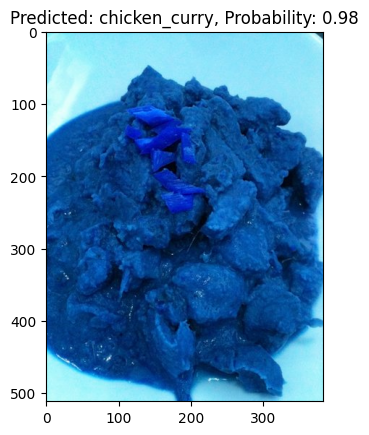

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


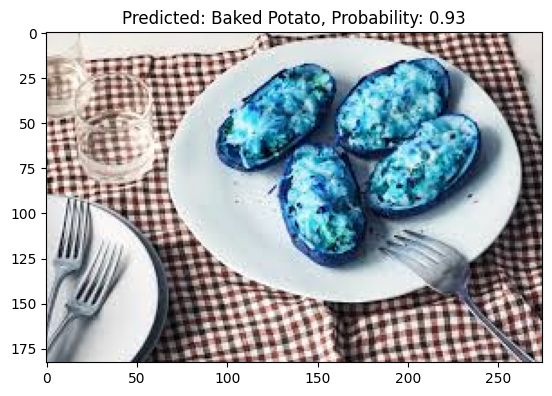

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


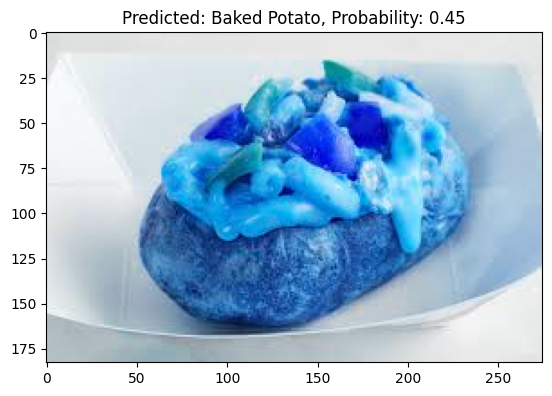

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


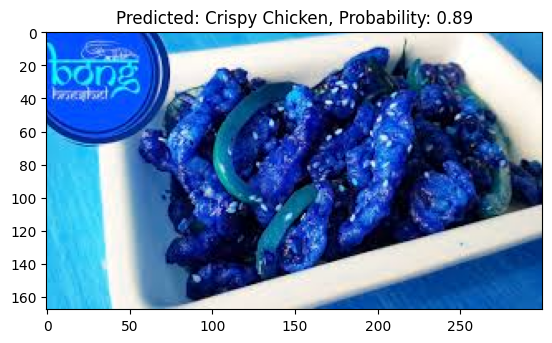

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


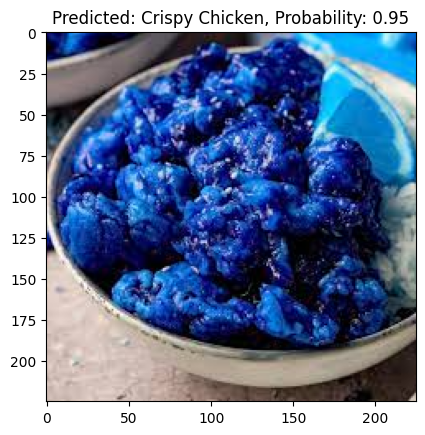

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


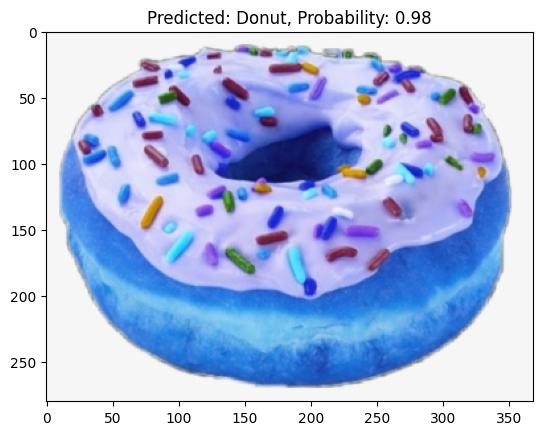

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


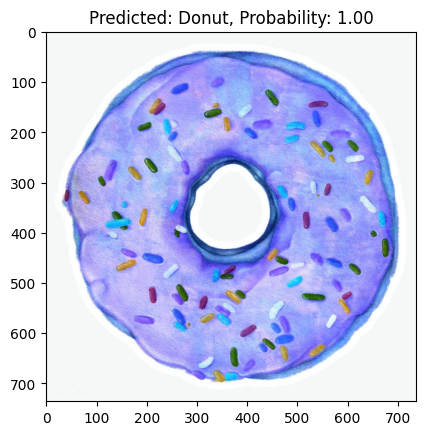

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


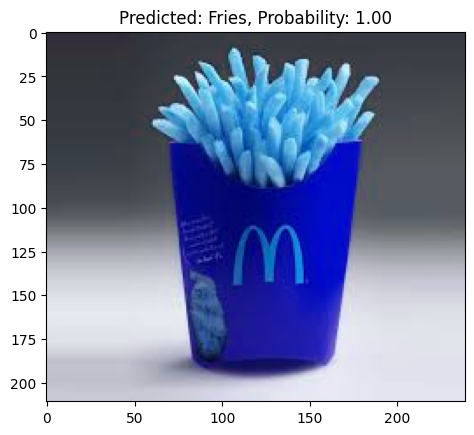

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


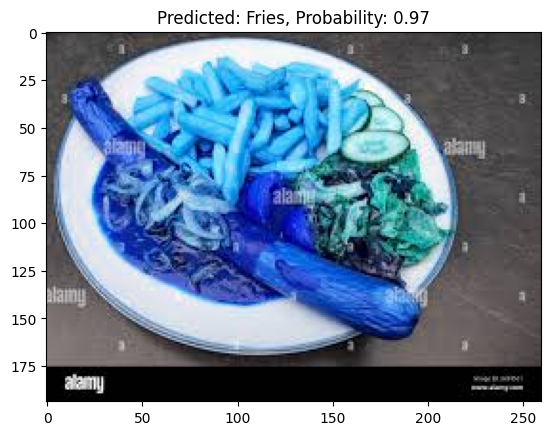

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


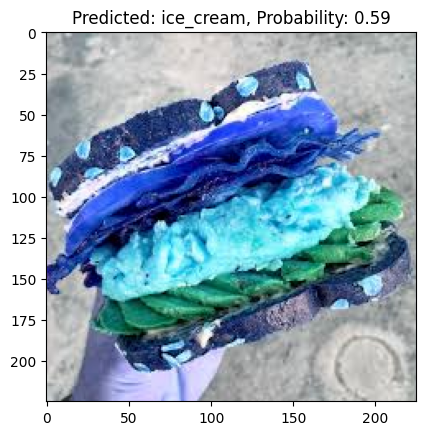

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


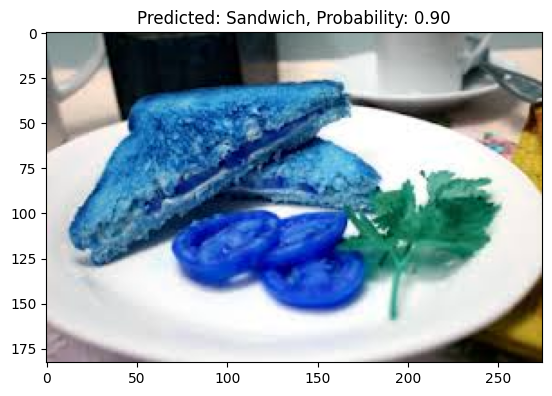

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


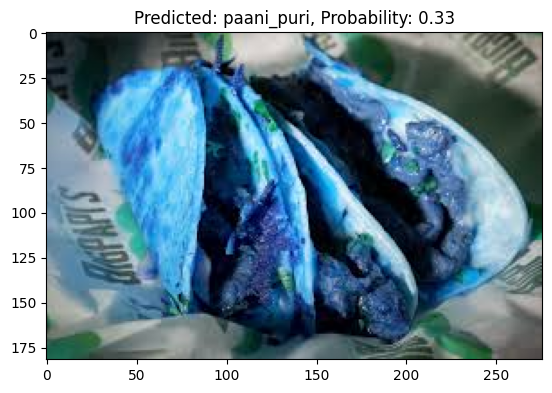

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


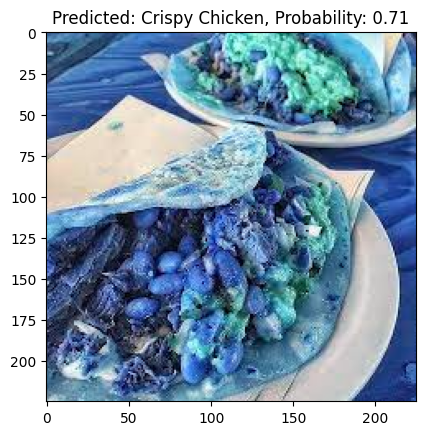

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


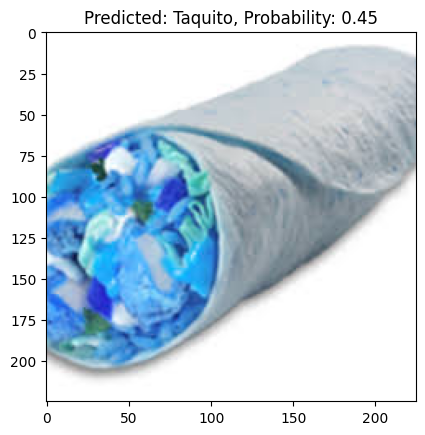

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


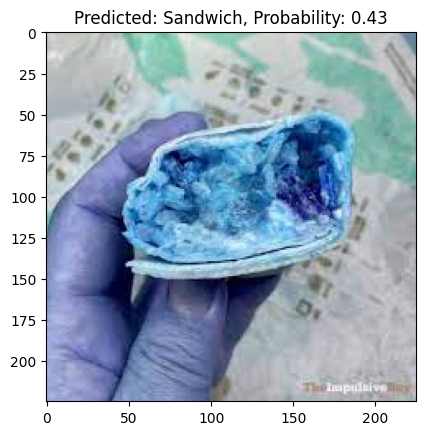

In [ ]:
# List all files in the directory
files = os.listdir()

# Apply model_output to all image files in the directory
for file in files:
    if file.endswith(('.jpeg', '.jpg', '.png')):  # Check for image file extensions
        model_output(file)

## Performance on 50 Random Images from Trained Data Set

In [ ]:
# Performance on 50 Random Images from Trained Data Set

In [ ]:
import numpy as np
import random
from tensorflow.keras.preprocessing import image
from sklearn.metrics import accuracy_score

# Function to load and preprocess a single image
def load_and_preprocess_image(img_path, target_size=(64, 64)):
    img = image.load_img(img_path, target_size=target_size)
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array /= 255.0  # Rescale the image
    return img_array

# Get list of all files in the test directory
train_files = []
for root, dirs, files in os.walk(r"F:\Work\DL_Test2\Food Classification dataset\split_data\train"):
    for file in files:
        if file.endswith(('.jpeg', '.jpg', '.png')):
            train_files.append(os.path.join(root, file))

# Randomly select 50 images
random_files = random.sample(train_files, 50)

# Get true labels and predicted labels
true_labels = []
predicted_labels = []

for file in random_files:
    # Get true label from the directory structure
    true_label = os.path.basename(os.path.dirname(file))
    true_labels.append(true_label)

    # Preprocess the image
    img_array = load_and_preprocess_image(file)

    # Predict the label
    prediction = classifier.predict(img_array)
    predicted_label_index = np.argmax(prediction)

    # Find the class label corresponding to the predicted index
    predicted_label = list(training_set.class_indices.keys())[list(training_set.class_indices.values()).index(predicted_label_index)]
    predicted_labels.append(predicted_label)

# Convert true labels to indices
true_labels_indices = [training_set.class_indices[label] for label in true_labels]

# Convert predicted labels to indices
predicted_labels_indices = [training_set.class_indices[label] for label in predicted_labels]

# Calculate accuracy
accuracy = accuracy_score(true_labels_indices, predicted_labels_indices)
print(f"Accuracy on 50 random trained images: {accuracy * 100:.2f}%")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━

In [ ]:
# Performance on 50 Random Images from Test Data Set

In [ ]:
# Get list of all files in the test directory
test_files = []
for root, dirs, files in os.walk(r"F:\Work\DL_Test2\Food Classification dataset\split_data\test"):
    for file in files:
        if file.endswith(('.jpeg', '.jpg', '.png')):
            test_files.append(os.path.join(root, file))

# Randomly select 50 images
random_files = random.sample(test_files, 50)

# Get true labels and predicted labels
true_labels = []
predicted_labels = []

for file in random_files:
    # Get true label from the directory structure
    true_label = os.path.basename(os.path.dirname(file))
    true_labels.append(true_label)

    # Preprocess the image
    img_array = load_and_preprocess_image(file)

    # Predict the label
    prediction = classifier.predict(img_array)
    predicted_label_index = np.argmax(prediction)

    # Find the class label corresponding to the predicted index
    predicted_label = list(training_set.class_indices.keys())[list(training_set.class_indices.values()).index(predicted_label_index)]
    predicted_labels.append(predicted_label)

# Convert true labels to indices
true_labels_indices = [training_set.class_indices[label] for label in true_labels]

# Convert predicted labels to indices
predicted_labels_indices = [training_set.class_indices[label] for label in predicted_labels]

# Calculate accuracy
accuracy = accuracy_score(true_labels_indices, predicted_labels_indices)
print(f"Accuracy on 50 random test images: {accuracy * 100:.2f}%")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
1/1 ━━━━━━━━

# Finish